In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


torch.Size([8, 3, 64, 64])


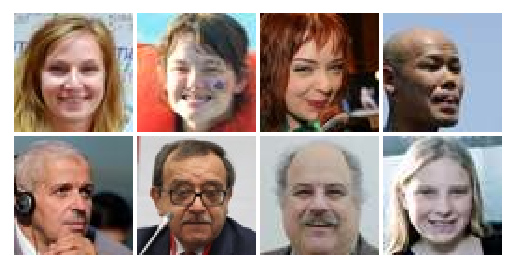

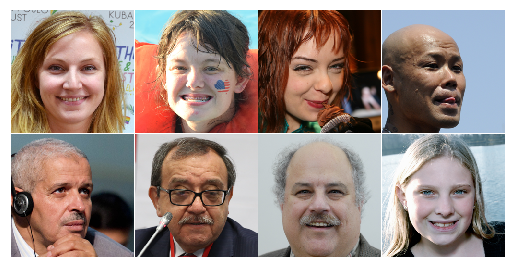

In [2]:
from PIL import Image

class RawDataset(torch.utils.data.Dataset):
    def __init__(self, dataset):
        import os
        self.filenames = sorted([s.split('.')[0] for s in os.listdir('00000/256')])
        if dataset == 'train':
            self.filenames = self.filenames[:800]
        if dataset == 'test':
            self.filenames = self.filenames[800:]
        self.n = len(self.filenames)

    def __len__(self):
        return self.n

    def __getitem__(self, i):
        f = self.filenames[i]
        f0 = f"00000/64/{f}.jpg"
        f1 = f"00000/256/{f}.png"
        v0 = np.array(Image.open(f0).convert("RGB"), dtype=np.float32) / 255.0
        v1 = np.array(Image.open(f1).convert("RGB"), dtype=np.float32) / 255.0
        return (
            np.transpose(v0, (2, 0, 1)),
            np.transpose(v1, (2, 0, 1))
        )


def plot_imgs(x):
    plt.figure()
    x = torch.clip(x, 0.0, 1.0)
    plt.imshow(np.transpose(vutils.make_grid(x[:8].cpu(),
        nrow=4, padding=2, pad_value=1, normalize=True), (1, 2, 0)),
                interpolation='nearest')
    plt.axis("off")
    plt.show()

for x, y in torch.utils.data.DataLoader(
    RawDataset('test'),
    batch_size=8,
    shuffle=True
):
    break

print(x.shape)
plot_imgs(x)
plot_imgs(y)

In [3]:
def conv3(nin, nout):
    return nn.Conv2d(nin, nout, 3, padding=1)

def relu(x):
    return F.relu(x, inplace=False)


class ResidualBlock(nn.Module):
    def __init__(self, n):
        super(ResidualBlock, self).__init__()
        self.conv1 = conv3(n, n)
        self.conv2 = conv3(n, n)
    
    def forward(self, x):
        return self.conv2(relu(self.conv1(x))) + x


class Modelx4(torch.nn.Module):
    def __init__(self, n_in, n_out, n_hidden, n_residual):
        super(Modelx4, self).__init__()

        self.conv_i = conv3(n_in, n_hidden)
        self.residual = nn.Sequential(
            *[ResidualBlock(n_hidden) for _ in range(n_residual)]
        )
        self.conv_m = conv3(n_hidden, n_hidden)
        self.upscale = nn.Sequential(
            conv3(n_hidden, 4*n_hidden),
            nn.ReLU(),
            nn.PixelShuffle(2),
            conv3(n_hidden, 4*n_hidden),
            nn.ReLU(),
            nn.PixelShuffle(2)
        )
        # self.conv_o = nn.Conv2d(n_hidden, n_out, 7, padding=3)
        self.conv_o = nn.Conv2d(n_hidden, n_out, 3, padding=1)
    
    def forward(self, x):
        x_i = relu(self.conv_i(x))
        x_r = self.residual(x_i)
        x_m = self.conv_m(x_r) + x_i
        x_u = self.upscale(x_m)
        x_o = torch.sigmoid(self.conv_o(x_u))
        return x_o


model = Modelx4(3, 3, 32, 10).to(device)
print(model)
x = torch.randn((8, 3, 64, 64), device=device)
with torch.no_grad():
    y = model(x)
print(y.shape)

Modelx4(
  (conv_i): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (residual): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (4): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): 

In [4]:
def conv3s2(nin, nout):
    return nn.Conv2d(nin, nout, 3, stride=2, padding=1)

class Discriminator(torch.nn.Module):
    def __init__(self, n_in, n_hidden):
        super(Discriminator, self).__init__()
        self.main = torch.nn.Sequential(
            conv3(n_in, n_hidden),
            nn.LeakyReLU(),
            conv3s2(n_hidden, n_hidden),  # 1 -> 1/2
            nn.BatchNorm2d(n_hidden),
            nn.LeakyReLU(),
            conv3(n_hidden, 2*n_hidden),
            nn.BatchNorm2d(2*n_hidden),
            nn.LeakyReLU(),
            conv3s2(2*n_hidden, 2*n_hidden),  # 1/2 -> 1/4
            nn.BatchNorm2d(2*n_hidden),
            nn.LeakyReLU(),
            conv3(2*n_hidden, 4*n_hidden),
            nn.BatchNorm2d(4*n_hidden),
            nn.LeakyReLU(),
            conv3s2(4*n_hidden, 4*n_hidden),  # 1/4 -> 1/8
            nn.BatchNorm2d(4*n_hidden),
            nn.LeakyReLU(),
            conv3(4*n_hidden, 8*n_hidden),
            nn.BatchNorm2d(8*n_hidden),
            nn.LeakyReLU(),
            conv3s2(8*n_hidden, 8*n_hidden),  # 1/8 -> 1/16
            nn.BatchNorm2d(8*n_hidden),
            nn.LeakyReLU(),
            nn.AdaptiveMaxPool2d((4, 4)),
            nn.Flatten(),
            nn.Linear(128*n_hidden, 32*n_hidden),
            nn.LeakyReLU(),
            nn.Linear(32*n_hidden, 1),
        )

    def forward(self, x):
        return self.main(x)


discriminator = Discriminator(3, 8).to(device)
print(discriminator)
x = torch.randn((8, 3, 256, 256), device=device)
with torch.no_grad():
    y = discriminator(x)
print(y.shape)
print(y)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Conv2d(8, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.01)
    (11): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): LeakyReLU(negative_slope=0.01)
    (14): Conv2d(32, 32, kernel_si

In [8]:
class CombinedLoss(torch.nn.Module):
    def __init__(self, lambda_a, lambda_p, lambda_f, lambda_t, lambda_c):
        super(CombinedLoss, self).__init__()
        self.lambda_a = lambda_a  # adversarial
        self.lambda_p = lambda_p  # pixel loss
        self.lambda_f = lambda_f  # feature loss (perceptual)
        self.lambda_t = lambda_t  # texture matching loss
        self.lambda_c = lambda_c  # correct color shift caused by GAN

        # loss function for GAN
        self.bce = torch.nn.BCEWithLogitsLoss()

        # VGG16 model for feature loss
        import torchvision.models
        vgg16 = torchvision.models.vgg16(weights='VGG16_Weights.DEFAULT')
        vgg_mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
        vgg_std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
        # first layer
        self.feature_extractor = vgg16.features[:4].to(device)
        for param in self.feature_extractor.parameters():
            param.requires_grad = False
        self.feature_extractor_1 = lambda x: self.feature_extractor((x-vgg_mean)/vgg_std)
        # print(self.feature_extractor)
        # second layer, after first layer
        self.feature_extractor_2 = vgg16.features[4:9].to(device)
        for param in self.feature_extractor_2.parameters():
            param.requires_grad = False
        # print(self.feature_extractor_2)
    
    # @staticmethod
    # def gram(x, s):
    #     # g = torch.einsum('kaij,kbij->kab', x, x)
    #     x1 = x.reshape((x.shape[0], x.shape[1], -1))
    #     g = torch.matmul(x1, x1.transpose(2, 1))
    #     return g / (x.shape[2]*x.shape[3])
            
    @staticmethod
    def gram(x, s):
        x = x.view(x.shape[0], x.shape[1], x.shape[2]//s, s, x.shape[3]//s, s)
        x = x.permute(0, 1, 2, 4, 3, 5).contiguous()
        x = x.view(x.shape[0], x.shape[1], -1, s*s)
        g = torch.matmul(x, x.transpose(3, 2))
        return g / (s*s)
    
    def forward(self, generated, target, discriminator_output, is_discriminator=False):
        # normalization parameters
        normalize_l2 = 1.0 / 0.05  # change this to estimated L1 loss
        normalize_vgg = 1.0 / 0.225
        normalize_l2_vgg = normalize_l2 / normalize_vgg
        normalize_l2_vgg_gram = normalize_l2_vgg ** 2

        # adversarial Loss
        if is_discriminator:
            return self.bce(discriminator_output, target)
        loss_a = -torch.mean(discriminator_output)

        # pixel loss (L1+L2)
        loss_p2 = torch.mean((generated-target)**2) * normalize_l2
        loss_p1 = torch.mean(torch.abs(generated-target))
        loss_p = 0.5*(loss_p1+loss_p2)

        # feature loss (L1+L2)
        gen_features = self.feature_extractor_1(generated)
        tgt_features = self.feature_extractor_1(target)
        loss_f1l2 = torch.mean((gen_features-tgt_features)**2) * normalize_l2_vgg
        loss_f1l1 = torch.mean(torch.abs(gen_features-tgt_features))
        gen_features_2 = self.feature_extractor_2(gen_features)
        tgt_features_2 = self.feature_extractor_2(tgt_features)
        loss_f2l2 = torch.mean((gen_features_2-tgt_features_2)**2) * normalize_l2_vgg
        loss_f2l1 = torch.mean(torch.abs(gen_features_2-tgt_features_2))
        loss_f = 0.25*(loss_f1l2+loss_f1l1+loss_f2l2+loss_f2l1)

        # texture loss
        # loss_t0 = torch.mean(self.gram(generated,256)-self.gram(target,256))**2 * normalize_vgg**2
        loss_t1 = torch.mean(self.gram(gen_features,16)-self.gram(tgt_features,16))**2
        loss_t2 = torch.mean(self.gram(gen_features_2,16)-self.gram(tgt_features_2,16))**2
        loss_t = (0.5*(loss_t1+loss_t2))**0.5 * normalize_l2_vgg_gram

        # color correction loss
        loss_cm = torch.mean(torch.mean(target-generated, axis=(2,3))**2) / normalize_l2
        loss_cd = torch.mean((torch.std(target,axis=(2,3))-torch.std(generated,axis=(2,3)))**2) / normalize_l2
        loss_c = loss_cm + loss_cd

        # Composite loss
        total_loss = \
            self.lambda_a * loss_a + \
            self.lambda_p * loss_p + \
            self.lambda_f * loss_f + \
            self.lambda_t * loss_t + \
            self.lambda_c * loss_c
        # print(loss_a.item(), loss_p.item(), loss_f.item(), loss_t.item(), loss_c.item())

        return total_loss


# training: set loss_a and loss_c to 0, wait for image to stabilize, then set it to 0.1, train again
# lossfun = CombinedLoss(0.0, 1.0, 1.0, 0.0, 4.0)
lossfun = CombinedLoss(0.1, 1.0, 1.0, 1.0, 4.0)
print(lossfun)

img1 = torch.randn((8, 3, 256, 256), device=device)
img2 = img1 + 0.05 * torch.randn_like(img1)
lossfun(img1, img2, discriminator(img1), False)

CombinedLoss(
  (bce): BCEWithLogitsLoss()
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (feature_extractor_2): Sequential(
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
  )
)


tensor(6.6053, device='cuda:0', grad_fn=<AddBackward0>)

In [9]:
optimizer = torch.optim.Adam(
    model.parameters(),
    lr=0.001
)
from torch.optim import lr_scheduler
scheduler = lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='min', factor=0.1, patience=10, min_lr=0.0, verbose=True)

optimizer_d = torch.optim.Adam(
    discriminator.parameters(),
    lr = 0.0005
)

discriminator_params = torch.cat([x.view(-1) for x in discriminator.parameters()])

8 g 9.3628568649292 d 3.655653238296509
16 g 7.825606346130371 d 1.7122899293899536
24 g 8.171165466308594 d 0.6443146467208862
32 g 6.376768589019775 d 0.23041591048240662
40 g 6.775513172149658 d 0.15024924278259277
48 g 6.757192611694336 d 0.3289598226547241
8 g 6.370611667633057 d 0.1296733021736145
16 g 7.119688034057617 d 0.09593099355697632
24 g 8.471961975097656 d 0.08699006587266922
Train loss: 8.58068561553955
Test loss: 8.269500732421875


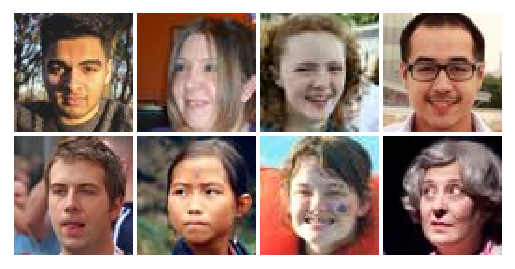

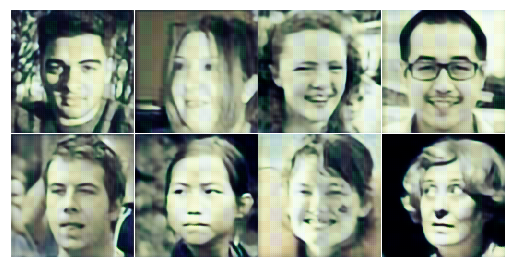

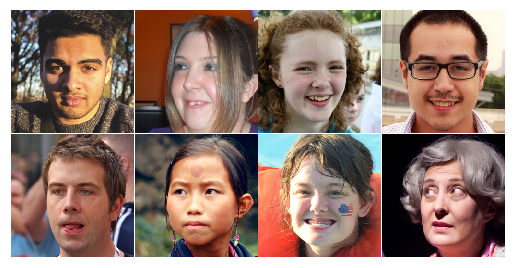

8 g 8.18896770477295 d 0.3294782042503357
16 g 7.873874664306641 d 1.0087361335754395
24 g 7.7405009269714355 d 0.18883396685123444
32 g 5.95128059387207 d 0.27403274178504944
40 g 6.7702956199646 d 0.4376494586467743
48 g 7.207667350769043 d 0.3813230097293854
8 g 6.446609020233154 d 0.6936682462692261
16 g 6.277084827423096 d 0.5653087496757507
24 g 5.589658737182617 d 0.7860376834869385
Train loss: 7.128664493560791
Test loss: 6.344020366668701


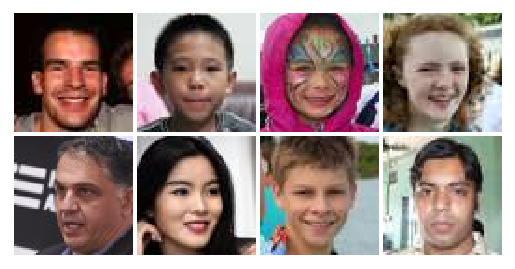

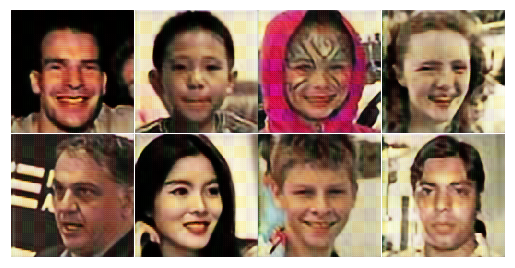

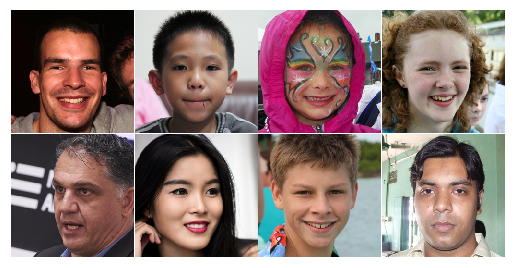

8 g 7.774875640869141 d 0.3499748706817627
16 g 7.656357288360596 d 0.4044460654258728
24 g 7.029512882232666 d 0.19413013756275177
32 g 5.727501392364502 d 0.6367390155792236
40 g 6.309456825256348 d 0.6205020546913147
48 g 6.037054061889648 d 0.9262810945510864
8 g 7.735043525695801 d 0.661423921585083
16 g 7.517366886138916 d 0.4397459924221039
24 g 7.36871337890625 d 1.0023549795150757
Train loss: 6.732181072235107
Test loss: 7.416443824768066


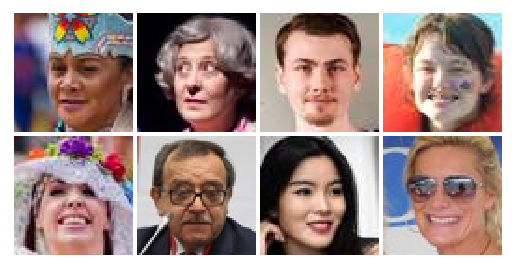

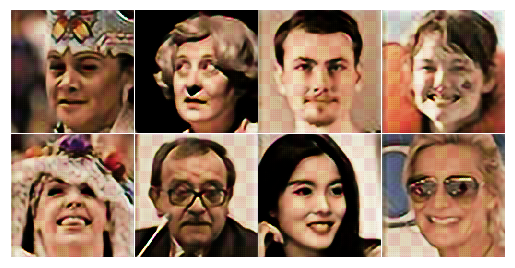

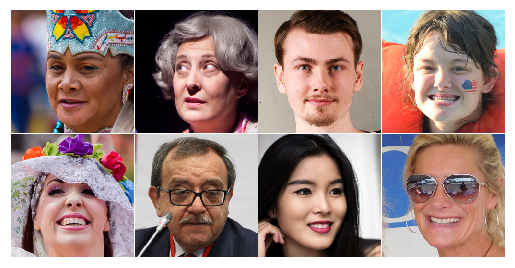

8 g 6.674938201904297 d 0.29820242524147034
16 g 5.63889217376709 d 0.5643655061721802
24 g 5.245085716247559 d 2.0898349285125732
32 g 5.748981475830078 d 1.000837802886963
40 g 6.40186882019043 d 0.4389469623565674
48 g 7.176924705505371 d 0.10938400030136108
8 g 5.560067176818848 d 0.10888221114873886
16 g 8.831782341003418 d 0.16516220569610596
24 g 5.000040054321289 d 0.24626964330673218
Train loss: 6.338977336883545
Test loss: 6.6568732261657715


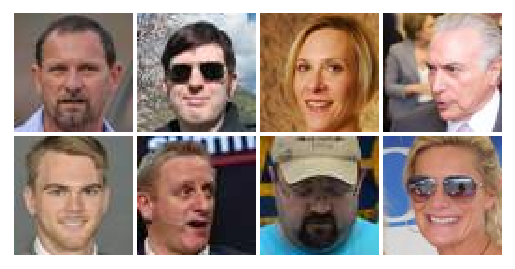

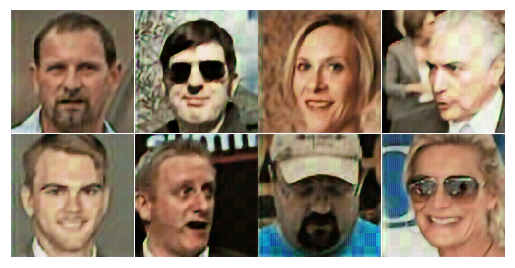

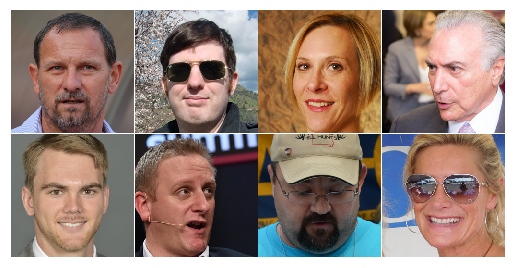

8 g 5.83362340927124 d 0.26744627952575684
16 g 6.831443786621094 d 0.14867925643920898
24 g 6.998739242553711 d 0.24781039357185364
32 g 6.8456339836120605 d 0.6639273166656494
40 g 5.529660224914551 d 0.31788480281829834
48 g 5.581787586212158 d 0.4420442581176758
8 g 8.73766040802002 d 0.17544206976890564
16 g 7.695329666137695 d 0.1768169403076172
24 g 6.195835590362549 d 0.16389738023281097
Train loss: 6.390357494354248
Test loss: 7.187991619110107


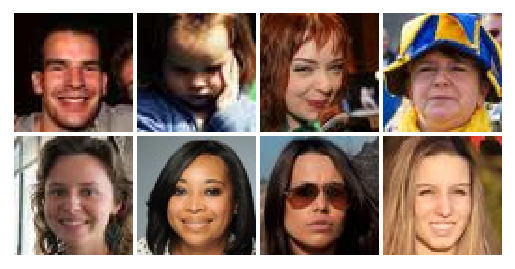

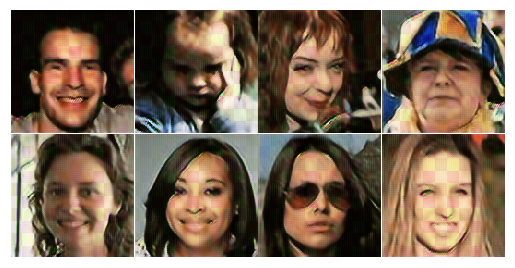

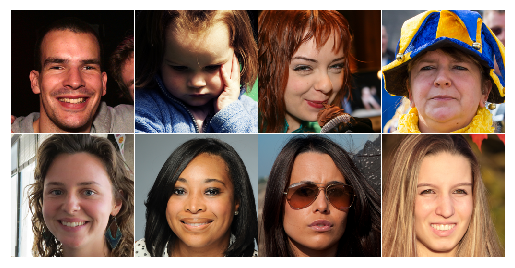

8 g 6.08873176574707 d 0.35462626814842224
16 g 5.704616546630859 d 0.38295137882232666
24 g 6.937501907348633 d 0.2772063910961151
32 g 5.584257125854492 d 0.20006826519966125
40 g 5.719409942626953 d 0.46555089950561523
48 g 6.836284160614014 d 0.7170576453208923
8 g 6.004120826721191 d 0.23272493481636047
16 g 6.740993022918701 d 0.28778260946273804
24 g 6.196719646453857 d 0.6184158325195312
Train loss: 6.253017425537109
Test loss: 6.170070648193359


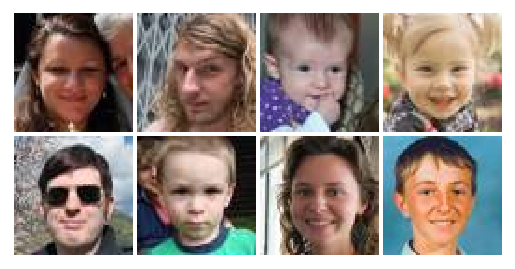

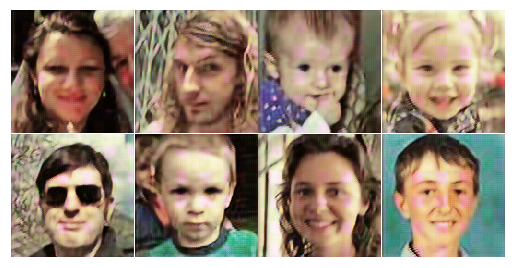

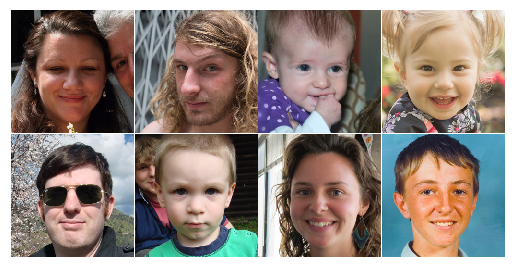

8 g 5.361769676208496 d 0.8111162185668945
16 g 5.773242473602295 d 0.8182430863380432
24 g 5.125059604644775 d 0.43600136041641235
32 g 7.550015926361084 d 0.45841747522354126
40 g 5.634048938751221 d 0.11690126359462738
48 g 5.667830467224121 d 0.07158282399177551
8 g 6.612912654876709 d 0.16294421255588531
16 g 5.1037678718566895 d 0.21800580620765686
24 g 7.279574394226074 d 0.265987366437912
Train loss: 6.126176834106445
Test loss: 6.193368434906006


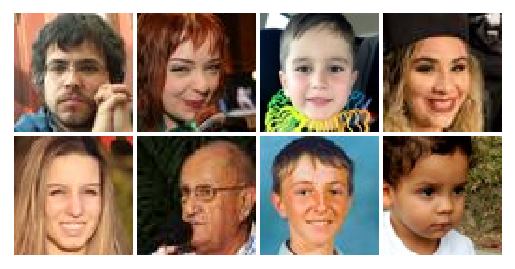

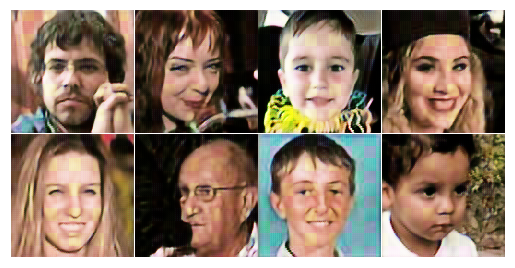

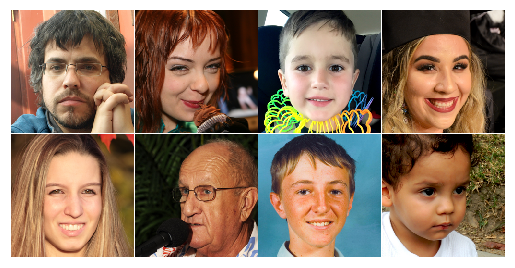

8 g 5.308071136474609 d 0.13577979803085327
16 g 5.569082260131836 d 0.6704012751579285
24 g 6.229119300842285 d 1.3514916896820068
32 g 5.613448619842529 d 0.04264778643846512
40 g 5.351844310760498 d 0.23967942595481873
48 g 5.87915563583374 d 0.16529102623462677
8 g 8.283255577087402 d 0.31556975841522217
16 g 8.746895790100098 d 0.5275424122810364
24 g 6.857649803161621 d 0.21733780205249786
Train loss: 6.164412021636963
Test loss: 7.174339294433594


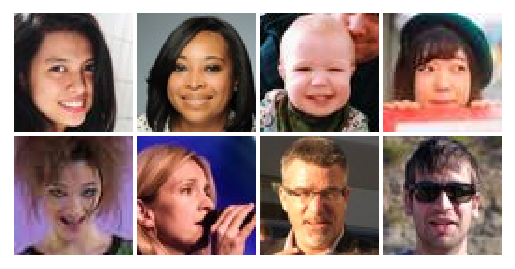

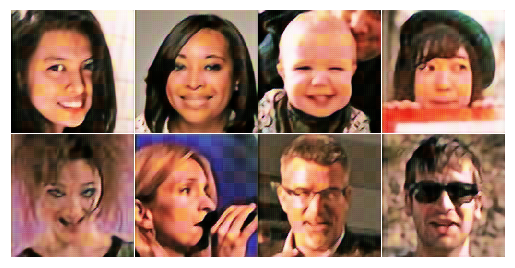

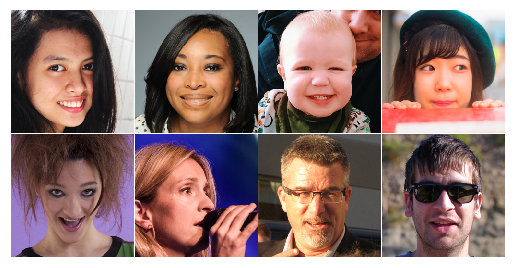

8 g 5.28236722946167 d 2.058030128479004
16 g 7.809213161468506 d 0.3613503575325012
24 g 6.980443954467773 d 2.4664154052734375
32 g 7.5420989990234375 d 0.37453973293304443
40 g 6.9771833419799805 d 1.2470067739486694
48 g 6.157741069793701 d 0.8179976344108582
8 g 5.170902252197266 d 0.7582252621650696
16 g 5.540112495422363 d 0.6798805594444275
24 g 6.007347106933594 d 0.6180621385574341
Train loss: 6.35695219039917
Test loss: 6.115609169006348


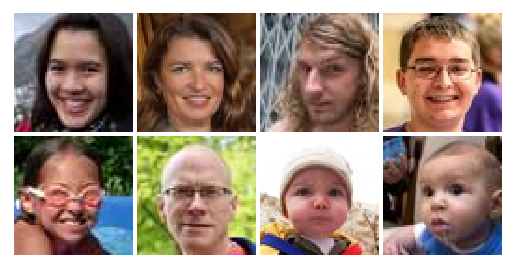

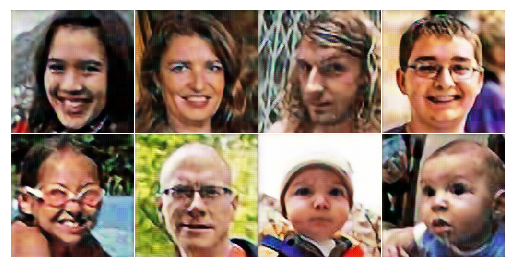

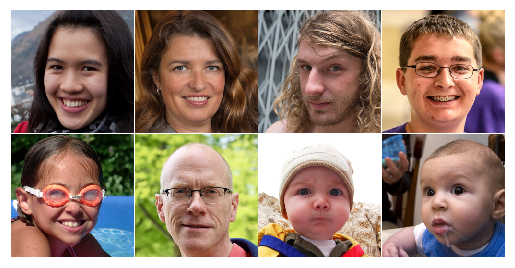

8 g 4.81099796295166 d 1.1634643077850342
16 g 7.213040351867676 d 1.3657324314117432
24 g 6.459831237792969 d 0.2158719301223755
32 g 6.014937400817871 d 0.2679879069328308
40 g 5.796605110168457 d 0.12505005300045013
48 g 5.708965301513672 d 0.3881855607032776
8 g 5.25826358795166 d 0.3221961259841919
16 g 4.905230522155762 d 0.2876172661781311
24 g 5.890280723571777 d 0.24520757794380188
Train loss: 5.805581092834473
Test loss: 5.744385242462158


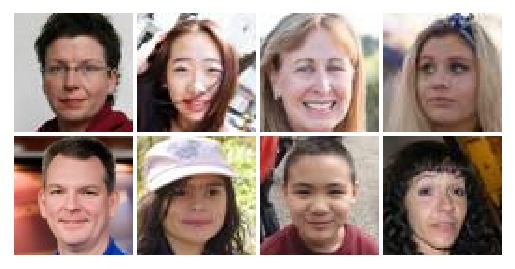

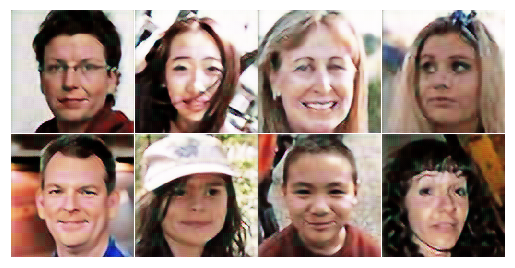

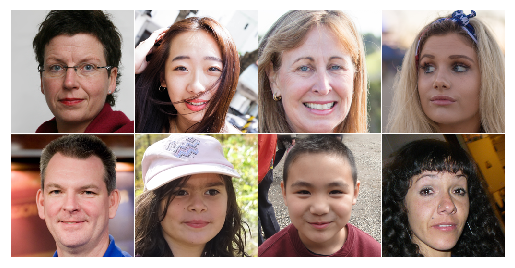

8 g 6.4548234939575195 d 1.1642680168151855
16 g 7.405864715576172 d 0.8000839948654175
24 g 4.716244220733643 d 0.4725636839866638
32 g 5.328436851501465 d 2.22768497467041
40 g 5.389678955078125 d 0.7223268747329712
48 g 5.8838677406311035 d 0.17955927550792694
8 g 7.617392539978027 d 0.2819305658340454
16 g 6.443711280822754 d 0.37938910722732544
24 g 6.189141273498535 d 0.2317531704902649
Train loss: 5.766520023345947
Test loss: 6.10769510269165


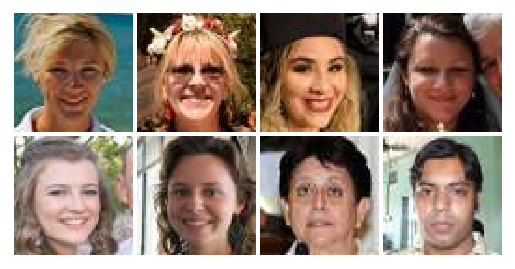

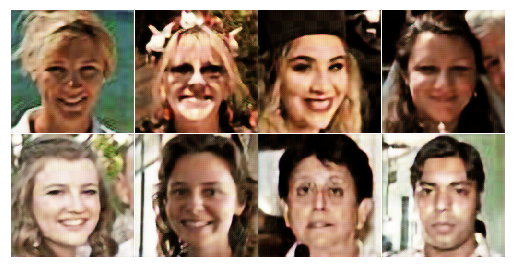

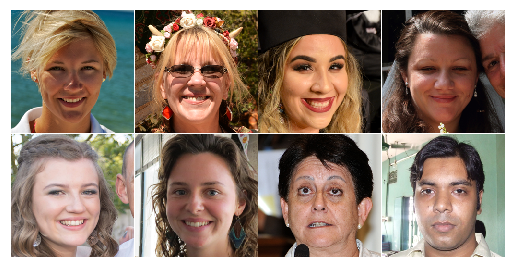

8 g 4.940799713134766 d 0.1416371464729309
16 g 5.346444606781006 d 0.1940610706806183
24 g 5.309950828552246 d 0.2587524950504303
32 g 5.51271915435791 d 1.1695090532302856
40 g 7.3159613609313965 d 0.4043115973472595
48 g 5.423098564147949 d 0.2917512059211731
8 g 4.481363773345947 d 0.5192647576332092
16 g 5.378635883331299 d 0.7062783241271973
24 g 5.438546180725098 d 0.7345288991928101
Train loss: 5.854490280151367
Test loss: 5.8925957679748535


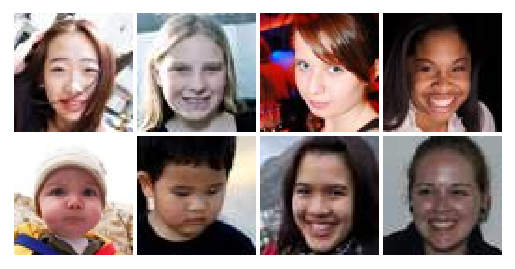

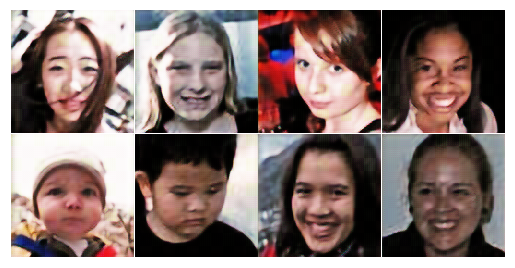

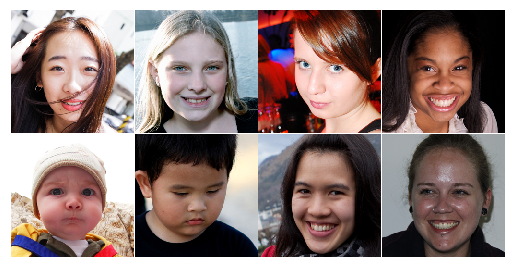

8 g 7.536700248718262 d 0.5312824249267578
16 g 5.553462982177734 d 0.33874863386154175
24 g 5.423666954040527 d 0.3163394033908844
32 g 5.348910331726074 d 0.1262187957763672
40 g 5.241480827331543 d 0.41509518027305603
48 g 5.580479145050049 d 0.4574965238571167
8 g 10.246624946594238 d 0.5474190711975098
16 g 8.32542896270752 d 0.2012248933315277
24 g 10.649248123168945 d 0.08020126074552536
Train loss: 5.908941745758057
Test loss: 9.44428539276123


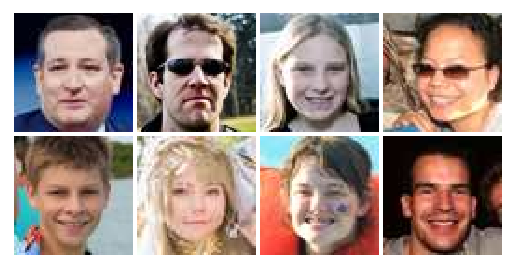

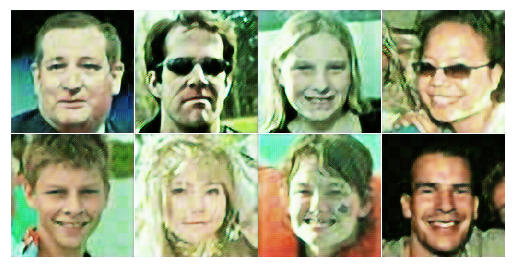

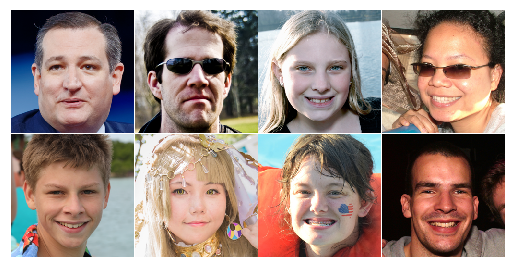

8 g 7.246077060699463 d 0.7969133853912354
16 g 6.5508131980896 d 0.1392190158367157
24 g 5.586342811584473 d 0.26139724254608154
32 g 7.143618106842041 d 0.2001548558473587
40 g 7.2919440269470215 d 0.71610426902771
48 g 5.417131423950195 d 0.11017677932977676
8 g 8.675695419311523 d 0.08520367741584778
16 g 5.935522079467773 d 0.29934126138687134
24 g 5.409306049346924 d 0.6542856693267822
Train loss: 6.578134536743164
Test loss: 7.05751371383667


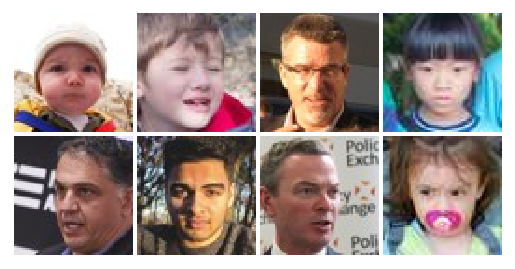

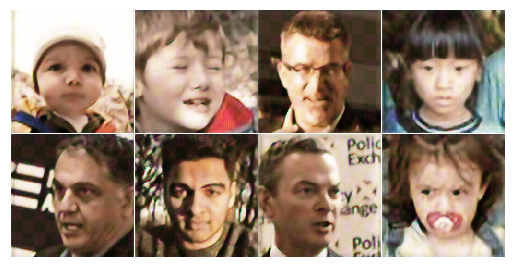

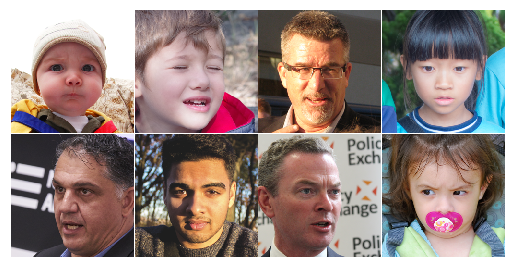

8 g 7.60695743560791 d 0.35694125294685364
16 g 6.611071586608887 d 0.07605303078889847
24 g 5.192643165588379 d 0.14811301231384277
32 g 8.479532241821289 d 0.26418745517730713
40 g 6.357365131378174 d 0.20501890778541565
48 g 7.344234943389893 d 0.2584321200847626
8 g 5.520487308502197 d 0.977633535861969
16 g 5.617945671081543 d 0.3858865201473236
24 g 5.905463695526123 d 0.265850305557251
Train loss: 6.306431293487549
Test loss: 6.556475639343262


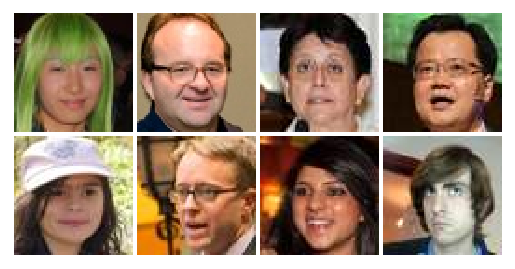

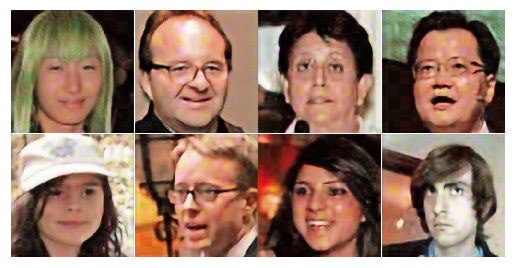

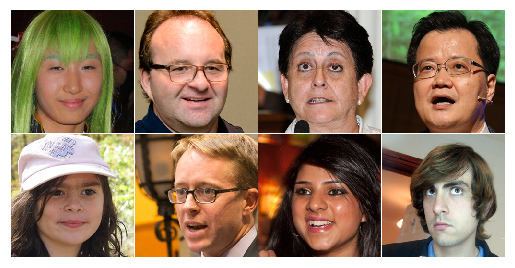

8 g 7.192978858947754 d 0.3327852487564087
16 g 6.302307605743408 d 0.07131588459014893
24 g 5.9278998374938965 d 1.1192337274551392
32 g 5.996142387390137 d 0.159144788980484
40 g 5.885828971862793 d 0.14253732562065125
48 g 5.500837802886963 d 0.11077294498682022
8 g 5.842906951904297 d 0.1396898478269577
16 g 5.143766403198242 d 0.11897334456443787
24 g 5.9234089851379395 d 0.8303261995315552
Train loss: 6.256200313568115
Test loss: 6.089999675750732


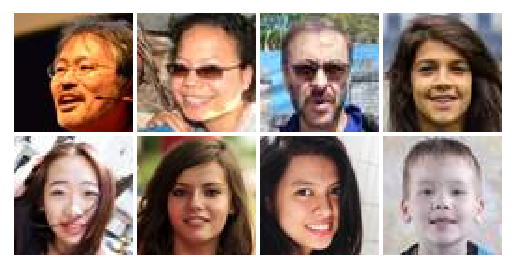

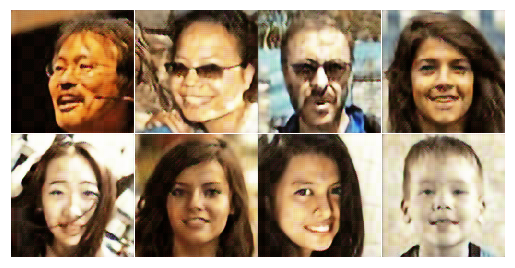

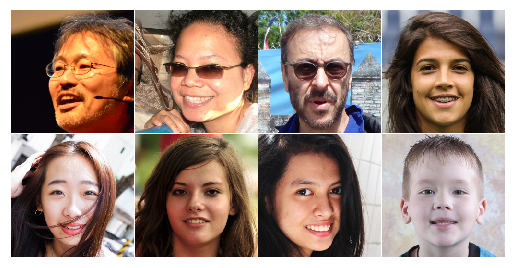

8 g 5.826605796813965 d 0.1476697474718094
16 g 7.482712268829346 d 0.2435058206319809
24 g 6.276024341583252 d 0.8314365148544312
32 g 6.164124488830566 d 0.4304811358451843
40 g 5.118800640106201 d 0.1010274738073349
48 g 5.838768005371094 d 0.12839670479297638
8 g 7.050383567810059 d 0.2181108295917511
16 g 6.697766304016113 d 0.11038483679294586
24 g 6.134128093719482 d 0.25035759806632996
Train loss: 6.200456619262695
Test loss: 6.389374732971191


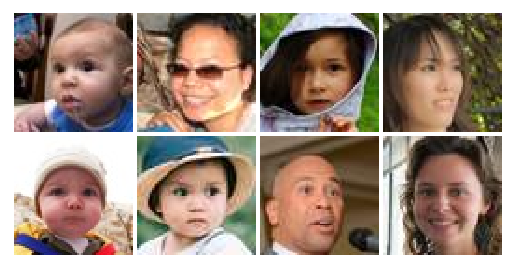

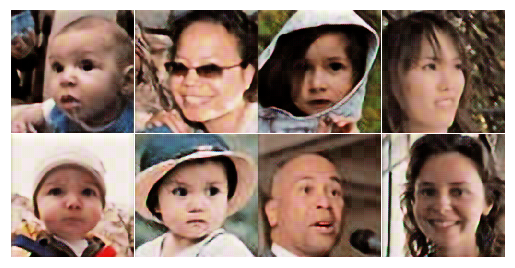

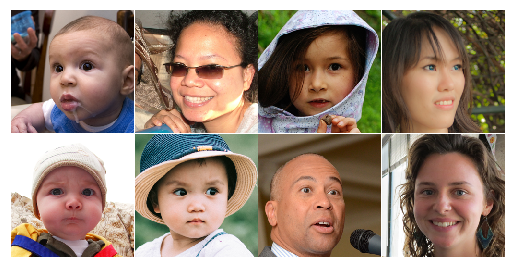

8 g 6.117175102233887 d 0.8239035606384277
16 g 6.45143461227417 d 0.15759629011154175
24 g 6.014285564422607 d 0.27758124470710754
32 g 6.565878868103027 d 0.23022425174713135
40 g 6.383485794067383 d 0.21428747475147247
48 g 6.357776641845703 d 0.3177226781845093
8 g 6.518404483795166 d 0.8350914716720581
16 g 6.755777359008789 d 0.2535734474658966
24 g 6.007116317749023 d 0.21845880150794983
Train loss: 6.182229042053223
Test loss: 6.488309383392334


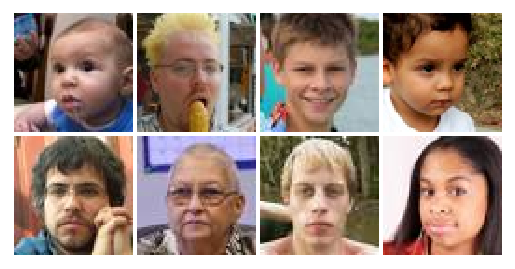

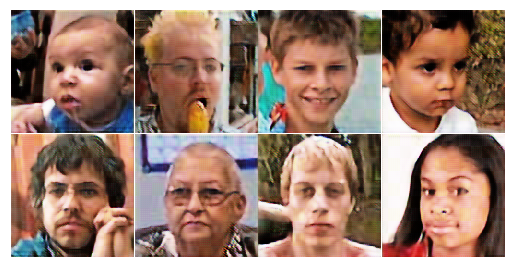

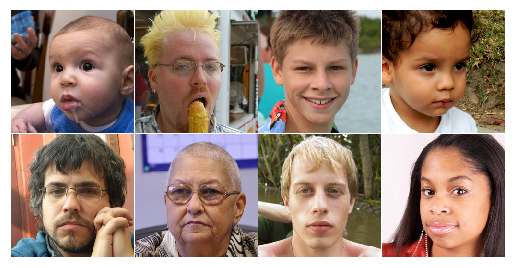

8 g 6.509347915649414 d 0.17460255324840546
16 g 6.030783653259277 d 0.34520286321640015
24 g 5.067849636077881 d 0.40449944138526917
32 g 5.722469806671143 d 0.11844094097614288
40 g 5.670559406280518 d 0.4586572051048279
48 g 5.7147064208984375 d 0.26140889525413513
8 g 6.3922834396362305 d 0.2176039069890976
16 g 6.283117294311523 d 0.09259705990552902
24 g 6.515655517578125 d 0.13482095301151276
Train loss: 6.052876949310303
Test loss: 6.352394104003906


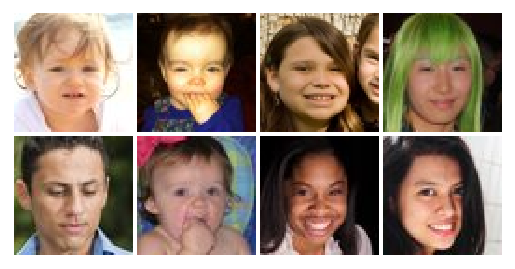

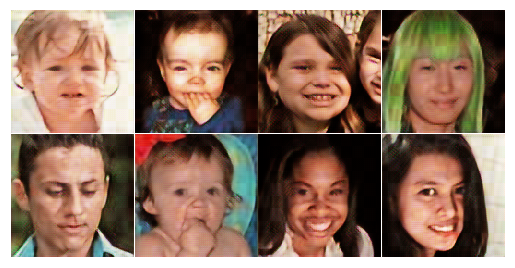

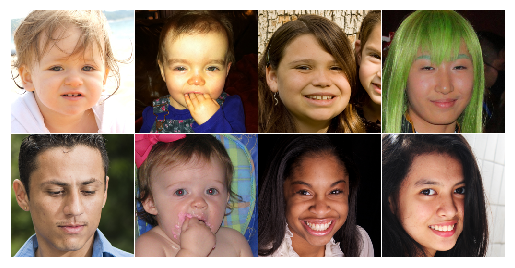

8 g 6.617271900177002 d 0.4399418830871582
16 g 6.629419326782227 d 1.5075808763504028
24 g 6.293557167053223 d 0.41590797901153564
32 g 5.600005626678467 d 0.33788976073265076
40 g 4.753601551055908 d 0.22309845685958862
48 g 5.875871181488037 d 0.22337055206298828
8 g 6.257002830505371 d 0.7389046549797058
16 g 6.393307209014893 d 1.131420612335205
24 g 5.596860885620117 d 1.7329696416854858
Train loss: 5.928633213043213
Test loss: 6.296205520629883


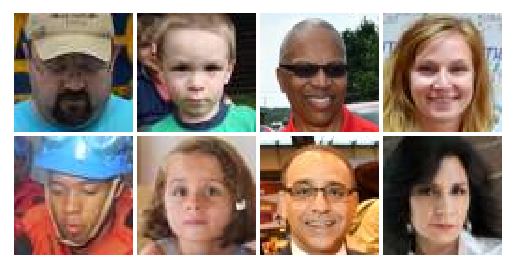

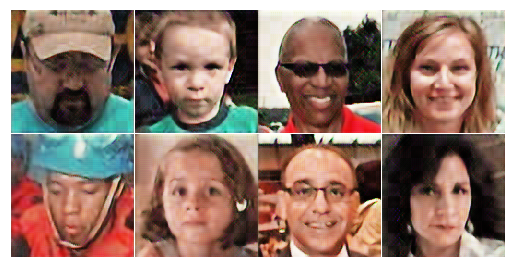

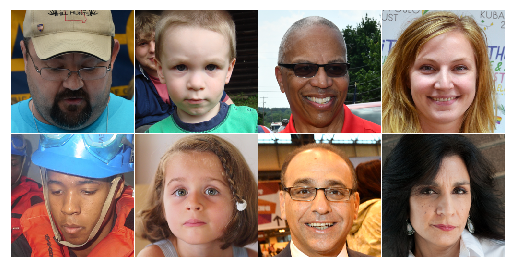

8 g 6.479547500610352 d 0.2646480202674866
16 g 5.869236469268799 d 0.19257044792175293
24 g 7.145852565765381 d 0.41421201825141907
32 g 5.581203460693359 d 1.384279727935791
40 g 6.142782688140869 d 0.5128687620162964
48 g 7.125499248504639 d 0.18957610428333282
8 g 5.396533966064453 d 0.7422294616699219
16 g 7.529197692871094 d 0.5898778438568115
24 g 5.0170745849609375 d 0.30310600996017456
Train loss: 6.1992411613464355
Test loss: 6.75465726852417


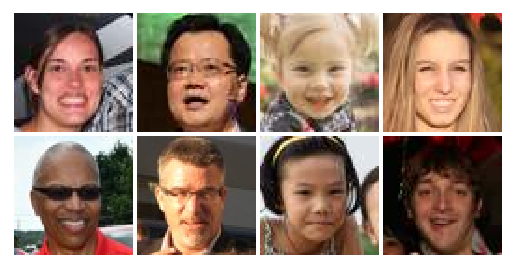

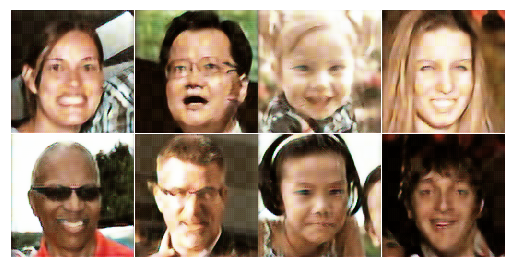

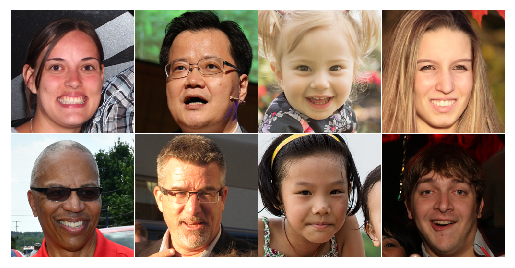

8 g 5.080750942230225 d 0.1571413278579712
16 g 6.5451250076293945 d 0.17444787919521332
24 g 6.9182305335998535 d 0.08676274120807648
32 g 6.079824447631836 d 0.08667677640914917
40 g 6.335718631744385 d 0.009359452873468399
48 g 5.597506523132324 d 0.012197427451610565
8 g 5.666254997253418 d 0.09627208858728409
16 g 6.711089611053467 d 0.0101552689447999
24 g 5.40710973739624 d 0.015797484666109085
Train loss: 6.19698429107666
Test loss: 6.101534843444824


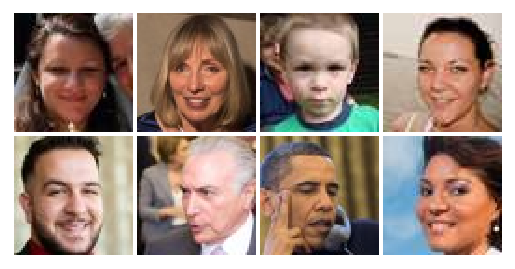

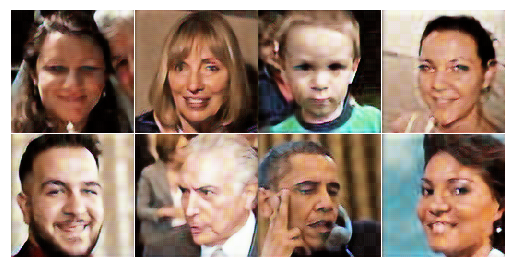

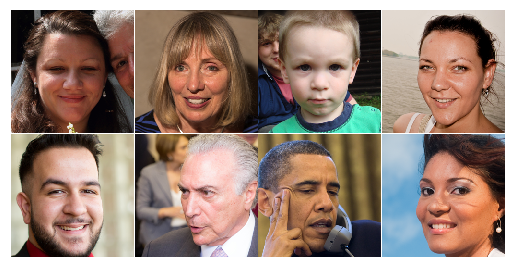

8 g 6.778640270233154 d 0.0131203169003129
16 g 5.951676368713379 d 0.1632234752178192
24 g 6.035358905792236 d 0.04439517483115196
32 g 5.234790802001953 d 0.1380879133939743
40 g 5.431581497192383 d 0.23424343764781952
48 g 5.666927337646484 d 0.3650687038898468
8 g 5.746699333190918 d 0.5461289286613464
16 g 5.839937686920166 d 0.39690515398979187
24 g 5.962838649749756 d 0.4000551402568817
Train loss: 5.907928943634033
Test loss: 6.172395706176758


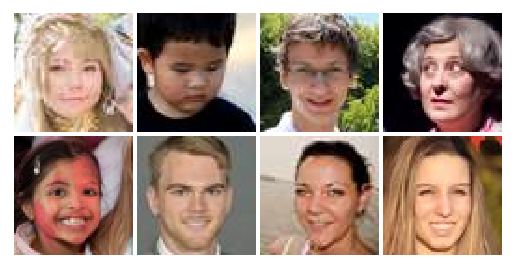

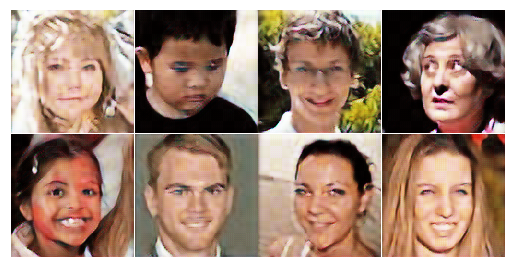

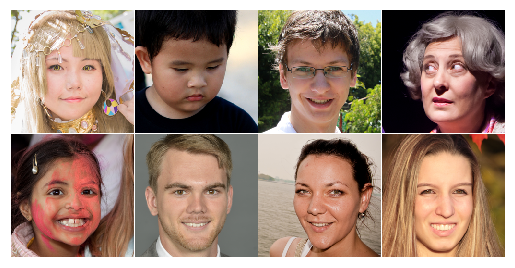

8 g 6.261534690856934 d 0.026632511988282204
16 g 6.24470329284668 d 0.024110374972224236
24 g 6.100119113922119 d 0.21139290928840637
32 g 6.116692066192627 d 0.028482303023338318
40 g 5.794281482696533 d 0.03245925158262253
48 g 5.7046308517456055 d 0.049232613295316696
8 g 6.000353813171387 d 0.28230807185173035
16 g 5.686623573303223 d 0.5751469731330872
24 g 6.049670696258545 d 0.056873977184295654
Train loss: 5.85308313369751
Test loss: 6.155060768127441


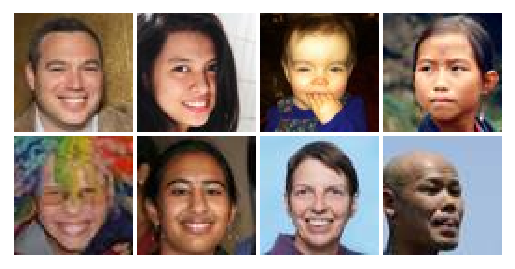

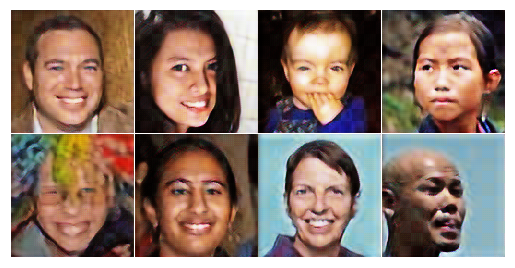

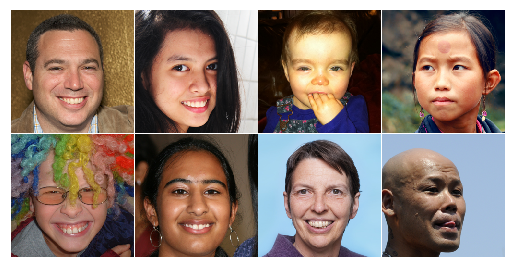

8 g 5.814849853515625 d 0.06428657472133636
16 g 5.967792987823486 d 0.05189846456050873
24 g 5.81029748916626 d 0.08224530518054962
32 g 5.136474132537842 d 0.15008455514907837
40 g 5.731748104095459 d 0.05119837820529938
48 g 5.479615211486816 d 0.021940141916275024
8 g 6.294716835021973 d 0.03482576459646225
16 g 5.31205415725708 d 0.3967507481575012
24 g 5.630796432495117 d 0.10928028076887131
Train loss: 5.747122764587402
Test loss: 6.138260364532471


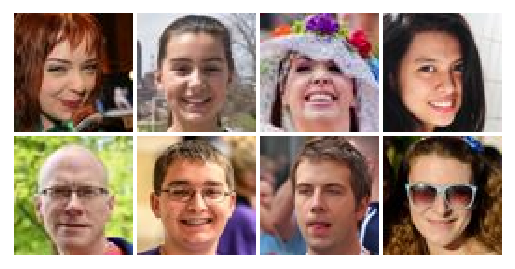

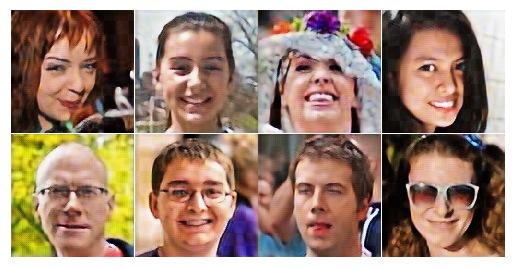

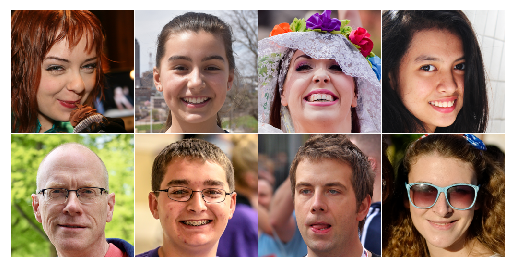

8 g 6.227919578552246 d 0.024991769343614578
16 g 5.4234747886657715 d 0.040243521332740784
24 g 5.100032806396484 d 0.07436157763004303
32 g 6.124751567840576 d 0.09677519649267197
40 g 5.76709508895874 d 0.11901092529296875
48 g 6.296738147735596 d 0.02971646562218666
8 g 5.9194512367248535 d 0.04359833151102066
16 g 5.835664749145508 d 0.031249821186065674
24 g 5.51388692855835 d 0.07979831099510193
Train loss: 5.717782974243164
Test loss: 6.0731730461120605


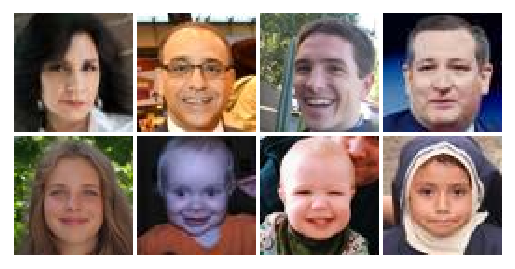

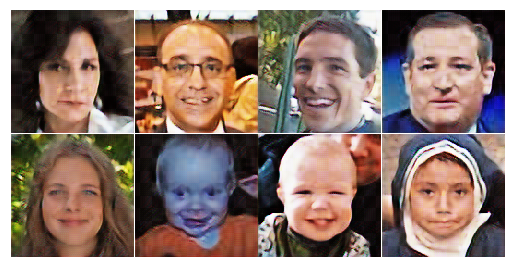

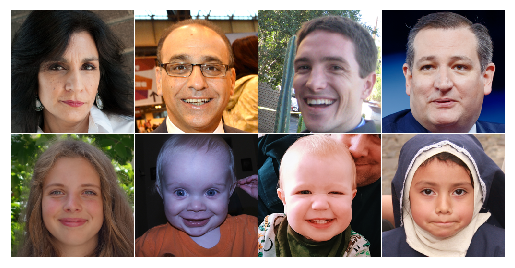

8 g 6.066023826599121 d 0.15440258383750916
16 g 5.79881477355957 d 0.04098695144057274
24 g 5.6436872482299805 d 0.11986987292766571
32 g 5.090609550476074 d 0.033221904188394547
40 g 6.392434120178223 d 0.18357425928115845
48 g 6.533581733703613 d 0.022324128076434135
8 g 6.471941947937012 d 0.21300192177295685
16 g 5.792788028717041 d 0.07484114170074463
24 g 5.717292785644531 d 0.07575629651546478
Train loss: 5.825901508331299
Test loss: 6.3681511878967285


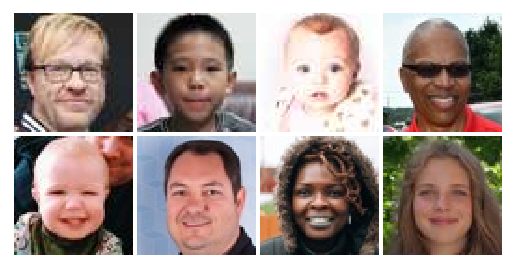

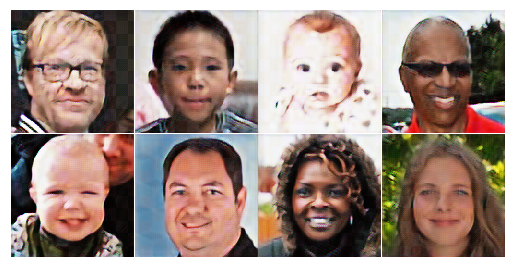

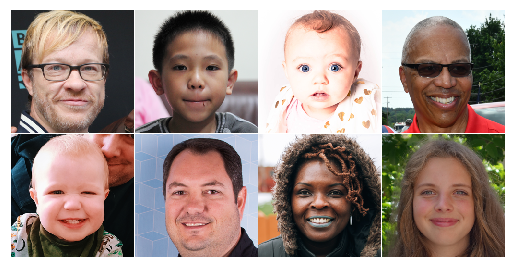

8 g 5.47922420501709 d 0.014996625483036041
16 g 5.894908905029297 d 0.06037284806370735
24 g 6.42787504196167 d 0.016176367178559303
32 g 5.97139835357666 d 0.03755314648151398
40 g 6.300366401672363 d 0.04734954982995987
48 g 5.776650428771973 d 0.40347903966903687
8 g 6.625380992889404 d 0.02388448640704155
16 g 6.753820896148682 d 0.2514166235923767
24 g 8.224274635314941 d 0.03940784931182861
Train loss: 5.874205589294434
Test loss: 6.441300392150879


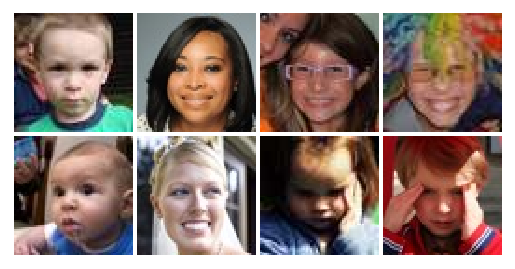

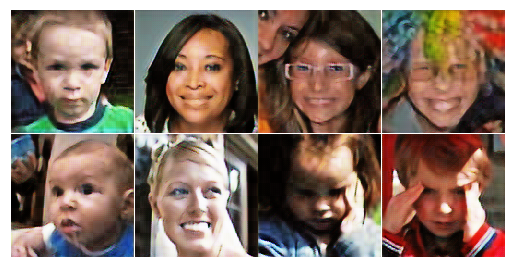

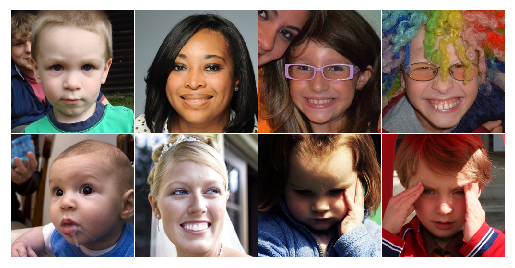

8 g 5.425726890563965 d 0.06577672064304352
16 g 5.665579795837402 d 0.020901305601000786
24 g 5.099678993225098 d 0.035897865891456604
32 g 5.321438312530518 d 0.03963126242160797
40 g 5.1966376304626465 d 0.1004517674446106
48 g 5.66486930847168 d 0.07126114517450333
8 g 6.030975818634033 d 0.2062802016735077
16 g 5.708903789520264 d 0.2548055350780487
24 g 5.34693717956543 d 0.08127370476722717
Train loss: 5.8102617263793945
Test loss: 6.259016036987305


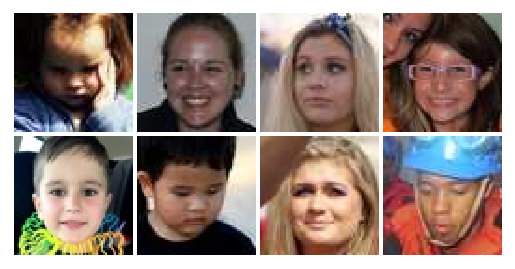

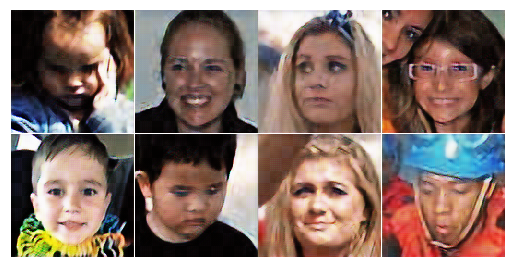

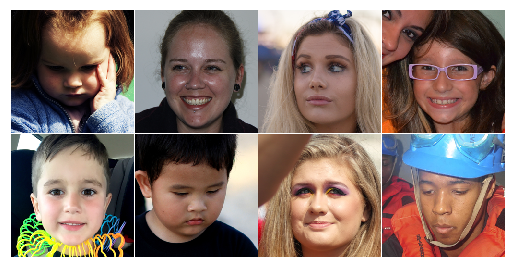

KeyboardInterrupt: 

In [10]:
def train_epoch(dataloader, test=False):
    total_loss = None
    batch_count = 0
    
    for x, y in dataloader:
        x = x.to(device)
        y = y.to(device)

        real_labels = torch.ones(x.shape[0], 1).to(device)
        fake_labels = torch.zeros(x.shape[0], 1).to(device)

        # Update Discriminator
        optimizer_d.zero_grad()
        real_outputs = discriminator(y)
        d_loss_real = lossfun(None, real_labels, real_outputs, is_discriminator=True)

        fake_images = model(x)
        fake_outputs = discriminator(fake_images.detach())
        d_loss_fake = lossfun(None, fake_labels, fake_outputs, is_discriminator=True)

        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        regl2 = 1.0 * torch.mean((discriminator_params)**2)
        regl2.backward()
        if not test:
            optimizer_d.step()

        # Update Generator
        optimizer.zero_grad()
        fake_outputs = discriminator(fake_images)
        g_loss = lossfun(fake_images, y, fake_outputs)
        g_loss.backward()
        if not test:
            optimizer.step()

        if total_loss is None:
            total_loss = g_loss
        else:
            total_loss += g_loss
        batch_count += 1

        if batch_count % 8 == 0:
            print(batch_count, 'g', g_loss.item(), 'd', d_loss.item())
    
    return total_loss / batch_count, (x, fake_images.detach(), y)


batch_size = 16

for epoch in range(10000):
    trainloader = torch.utils.data.DataLoader(
        RawDataset('train'), batch_size=batch_size, shuffle=True)
    testloader = torch.utils.data.DataLoader(
        RawDataset('test'), batch_size=8, shuffle=True)
    
    train_loss, _ = train_epoch(trainloader)
    test_loss, _ = train_epoch(testloader, test=True)

    model_g_path = "model03_g.pth"
    model_d_path = "model03_d.pth"
    torch.save(model, model_g_path)
    torch.save(discriminator, model_d_path)

    print("Train loss:", train_loss.item())
    print("Test loss:", test_loss.item())
    scheduler.step(test_loss)
    if optimizer.param_groups[0]['lr'] < 1e-4:
        break

    if epoch % 1 == 0:
        plot_imgs(_[0])
        plot_imgs(_[1])
        plot_imgs(_[2])
